# Imports 

In [1]:
print('hi')

hi


In [2]:
import sys
sys.path

['/home/eag190/Multimode-Conditional-Displacements/hpc_runs/multimode_circle_grape/varying_alpha_chi_time_qubitamp',
 '/home/eag190/miniconda3/envs/simulations/lib/python39.zip',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/lib-dynload',
 '',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/site-packages',
 '/cache/home/eag190/ECD_control',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/site-packages/quantum_optimal_control-0.1.0-py3.9.egg']

In [3]:
%matplotlib inline
import os
import sys
import inspect
import numpy as np
from scipy.special import factorial
import h5py

#data_path = '/data'     ... data path specified later
#data_path
#initial_pulse = '../pulses/example_pulses/transmon_cat_initial_pulse.h5'
from h5py import File
import matplotlib.pyplot as plt
from pylab import*
from qutip import*

from scipy import interpolate
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)


In [4]:
from quantum_optimal_control.helper_functions.grape_functions import *
from quantum_optimal_control.main_grape.grape import Grape
from quantum_optimal_control import*

In [5]:
%load_ext autoreload
%autoreload 2

$$\newcommand{\ket}[1]{\left|{#1}\right\rangle}
\newcommand{\bra}[1]{\left\langle{#1}\right|}$$

# 3DMM2 parameters

In [6]:
chis = 2*array([-33]) 
kappas  = array([0]) # kHz

# Multimode circle grape

In [7]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
#TODO: Figure out why relative import doesn't work
from circle_grape_v3 import *

done


In [9]:
transmon_levels = 2

# Data Storage

In [11]:
import pandas as pd
fname = 'dataset_sweep_chi_alpha_qubitamp_time2.csv'
columns=['time', 'steps', 'chi', 'alpha', 'qubit_amp', 'detuning', 'err']
df = None

# Main

In [12]:
times = [500, 1000, 1500, 2000]
alphas = [15,20, 25, 30]
qubit_amps = [1e-2, 1e-3, 1e-4]
chi_factors = [1e-6, 1e-5, 1e-4]

In [14]:
def main(fname = fname, df = df):
    '''
    Vary time length, get fidelity
    '''
    for chi_factor in chi_factors: 
        for alpha in alphas:
            for qubit_amp in qubit_amps:
                for total_time in times: 

                    print(total_time)
                    #param
                    mode = 0
                    mode_levels = 10
                    chi, kappa= chis[mode-1]*chi_factor, kappas[mode-1]*1e-6   #MHz, kHz
                    cavity_detuning = -0.010


                    #circle grape params
                    circle_grape_params = {"chis":[chi],"kappas":[kappa],"alpha":alpha,"delta_c":cavity_detuning}
                    convergence = {'rate': 0.1, 'update_step': 10, 'max_iterations': 1000,
                   'conv_target': 1e-5, 'learning_rate_decay': 500.0}

                    initial_guess = None
                    steps = 250 #number of points over the total time where amplitudes will be specified
                    #total_time = time
                    states_forbidden_list = []
                    reg_coeffs = {'dwdt': 0.1, 'd2wdt2': 1.0e-3, 'forbid_dressed': False,
                                  'states_forbidden_list':[],
                                  'forbidden_coeff_list': [1.0*steps] * len(states_forbidden_list)}



                    #class
                    op = multimode_circle_grape_optimal_control(mode_state_num = mode_levels,
                                                            number_of_modes = 1,hparams = circle_grape_params,add_disp_kerr=False)
                    ss = op.run_optimal_control(state_transfer = True, initial_states = [0], target_states = [1], 
                                        total_time = total_time, steps = steps,max_amp = qubit_amp, 
                                        taylor_terms = None,is_dressed=False, 
                                        convergence = convergence, reg_coeffs =  reg_coeffs,
                                        plot_only_g = True,
                                        states_forbidden_list = [], initial_guess = initial_guess, 
                                        file_name="g0_to_g1_circlgrape", data_path=data_path, save = True)
                    hf = op.openfile()
                    err  = min(hf['error'])
                    if np.isnan(err):
                        err = -1
                    df_new = pd.DataFrame([[total_time, steps, chi, alpha, qubit_amp, cavity_detuning,  err]], columns=columns)
                    if df is None : 
                        df = df_new
                    else:
                        df = df.append(df_new, ignore_index = True)
                    df.to_csv(fname, index=False)

data saved at: /home/eag190/Multimode-Conditional-Displacements/hpc_runs/multimode_circle_grape/sample workflow/data/00143_g0_to_g1_circlgrape.h5


/tmp/ipykernel_48641/3747153437.py:51: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_new, ignore_index = True)


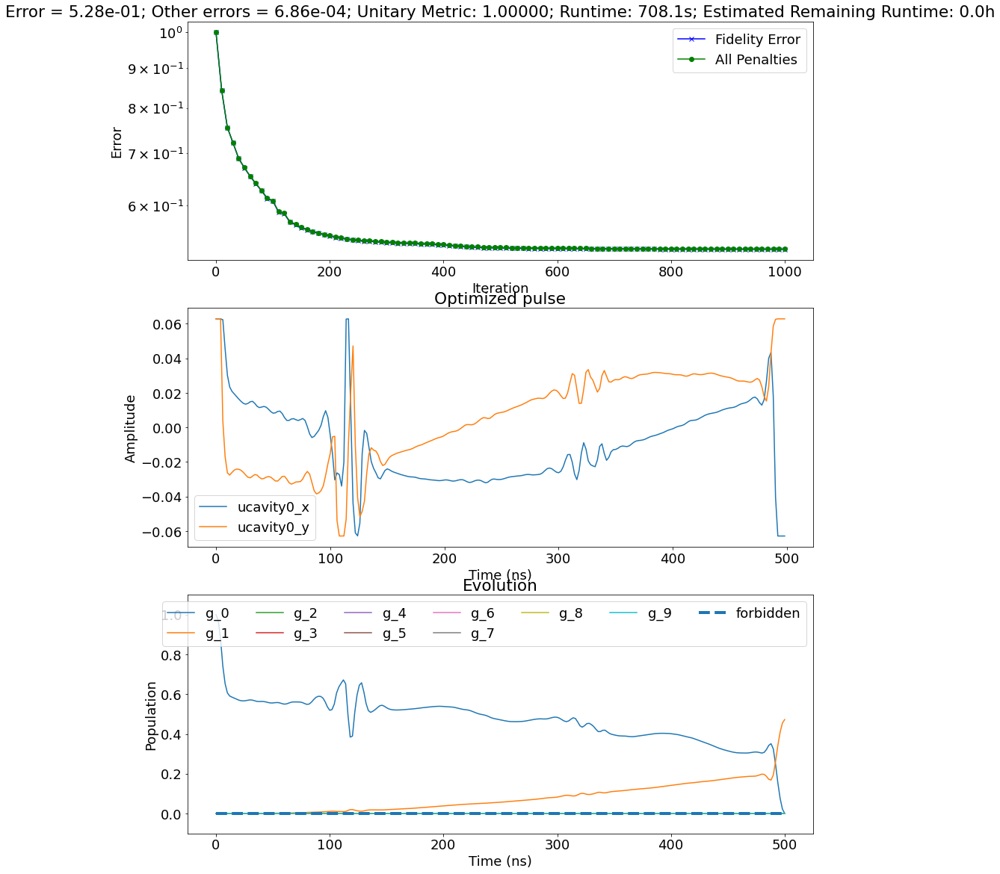

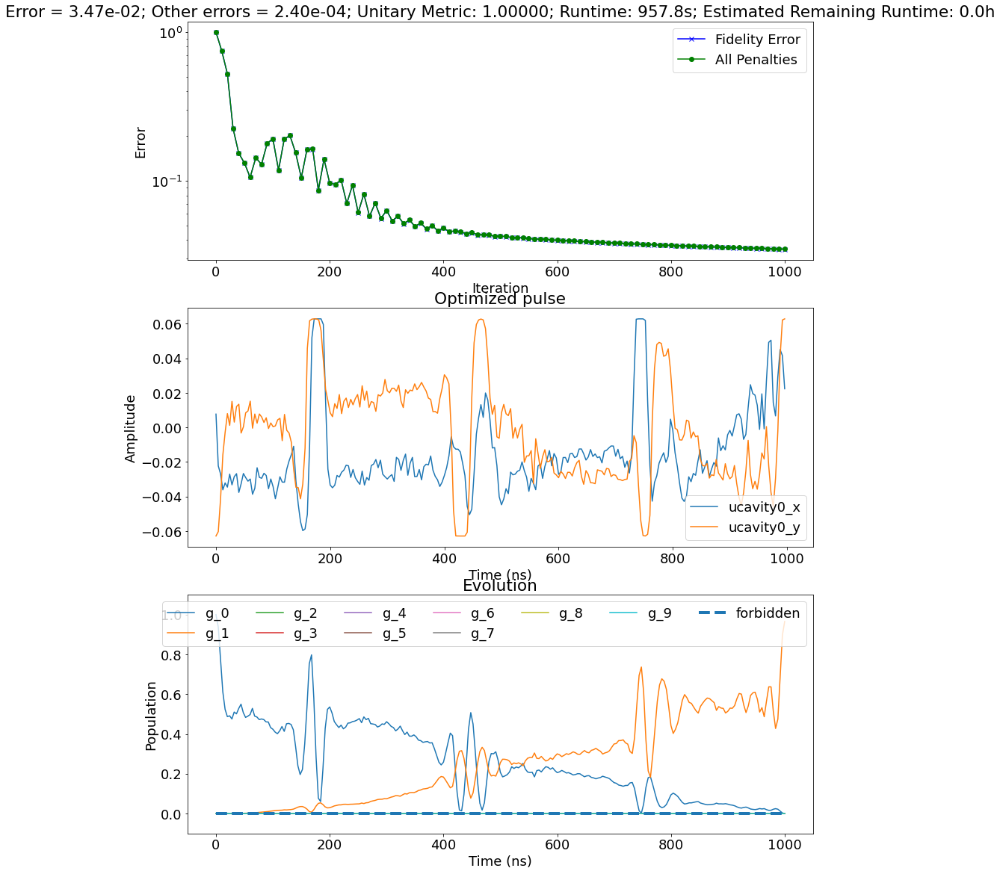

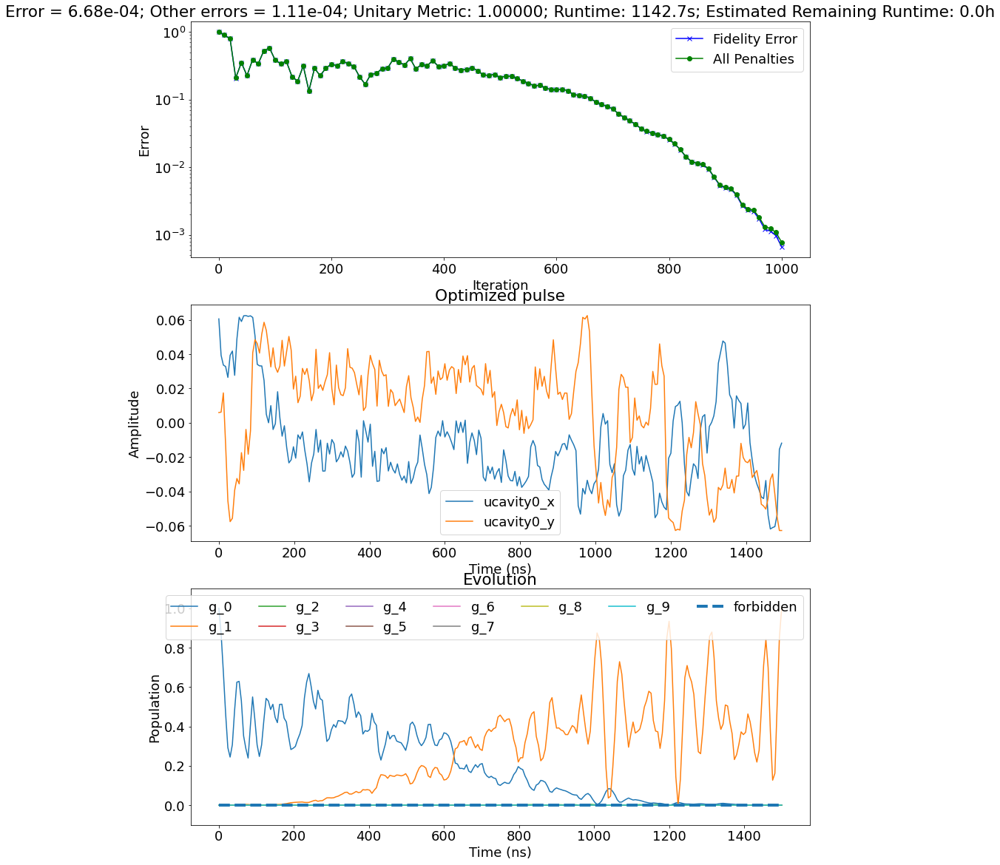

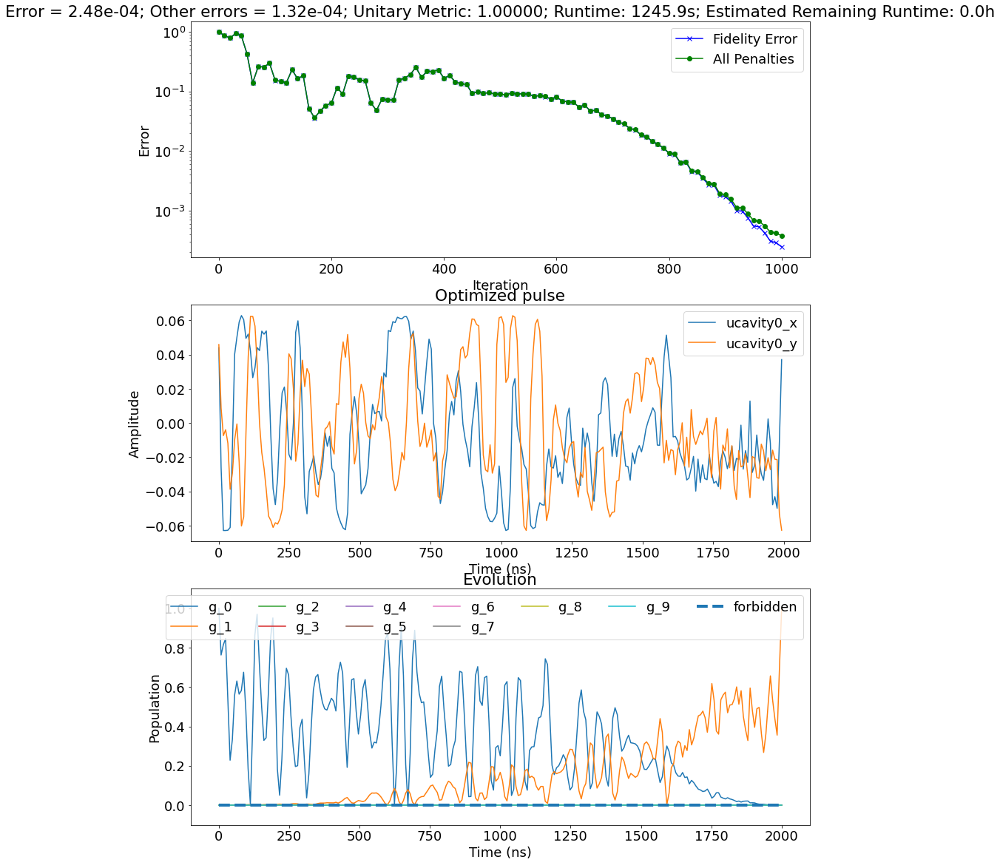

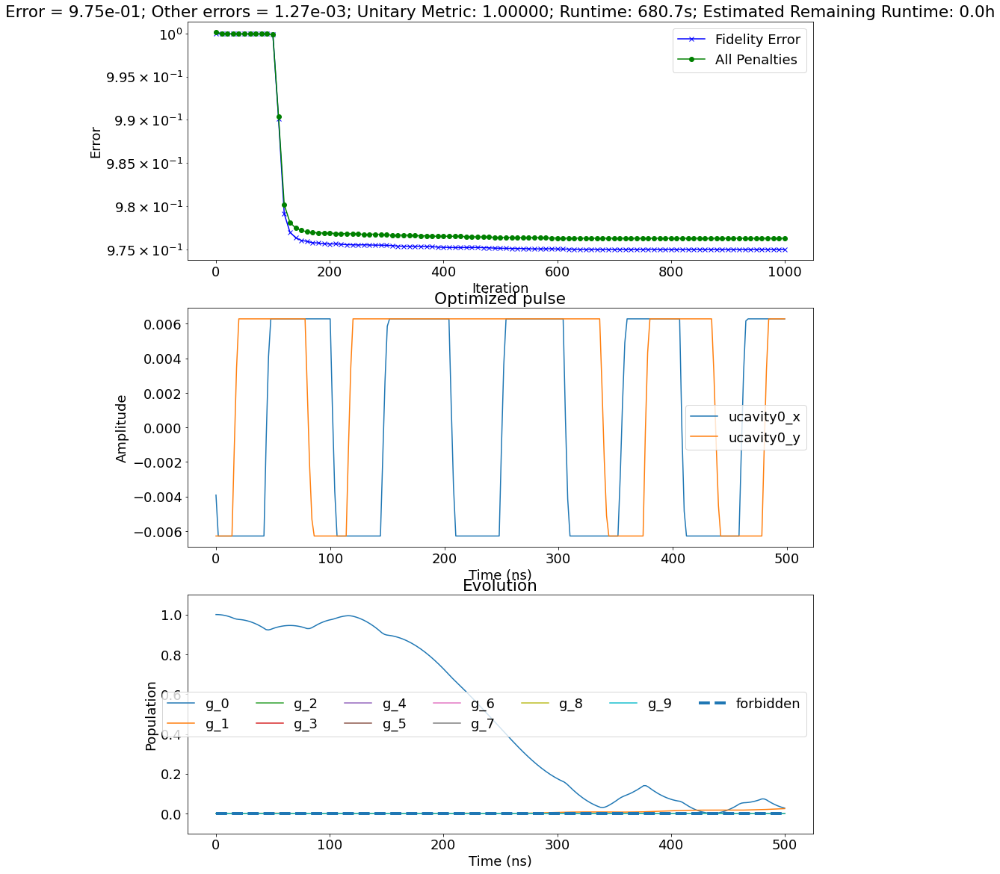

...

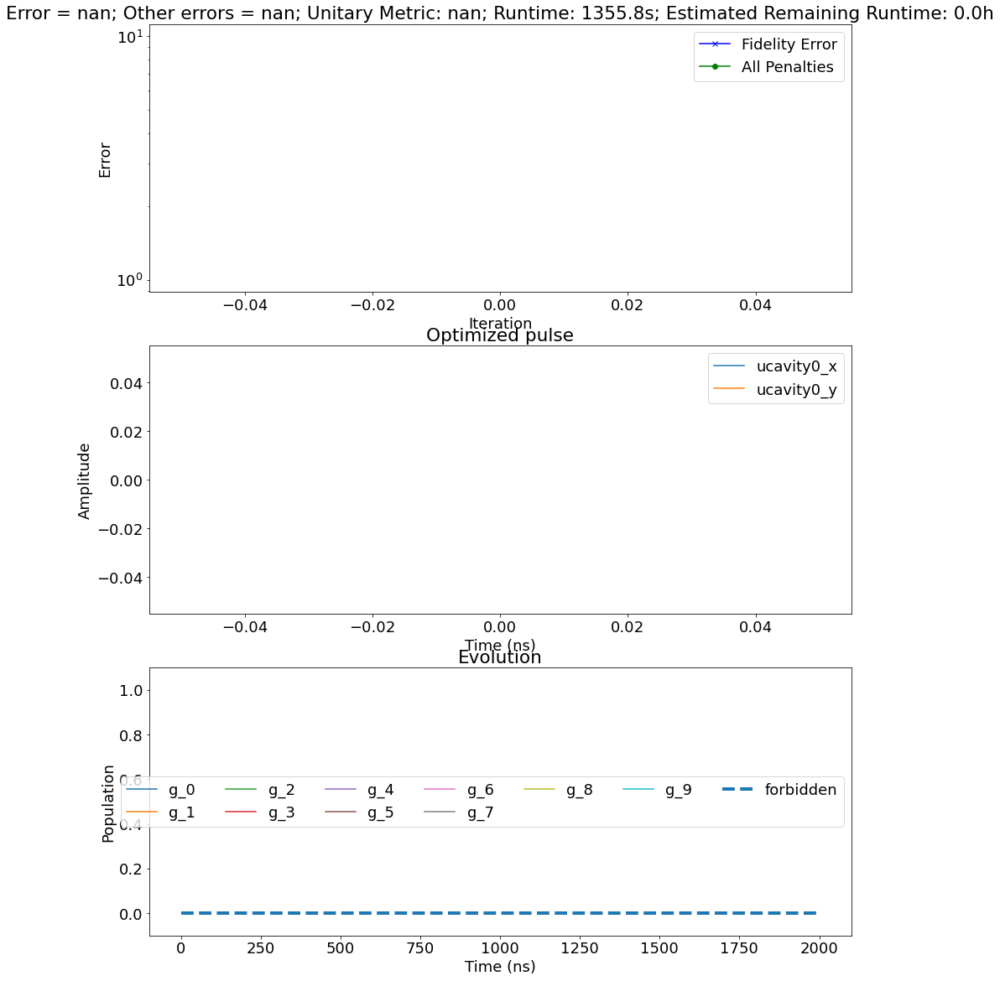

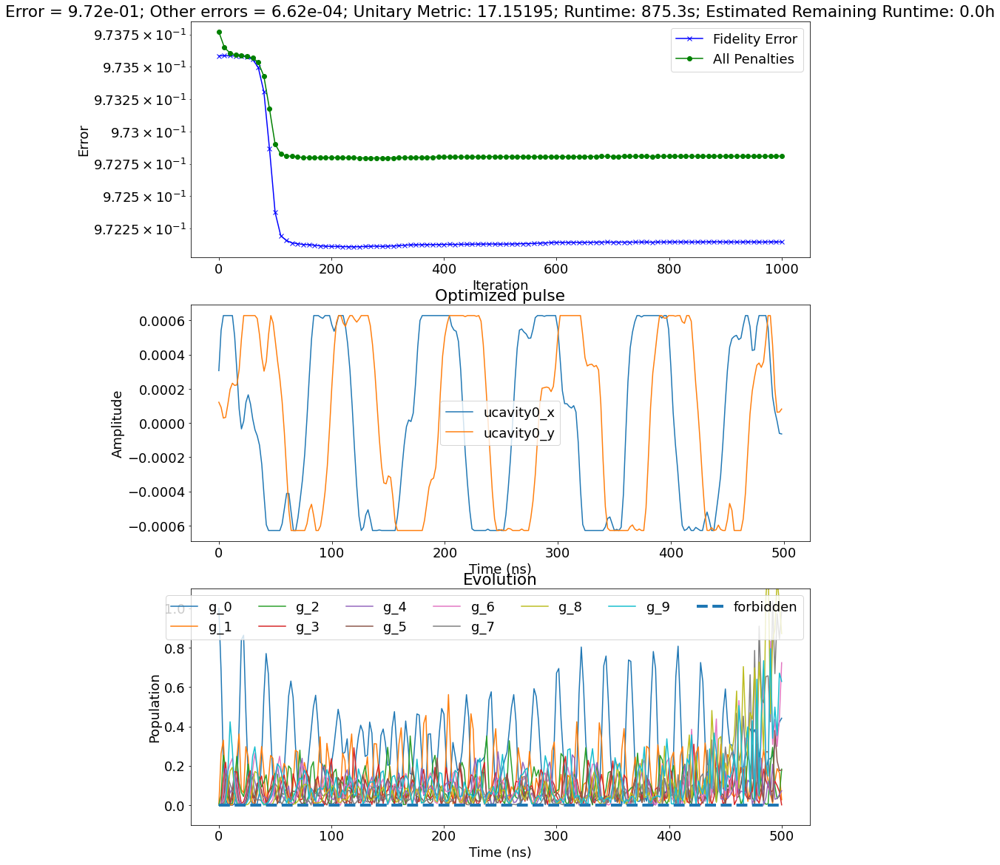

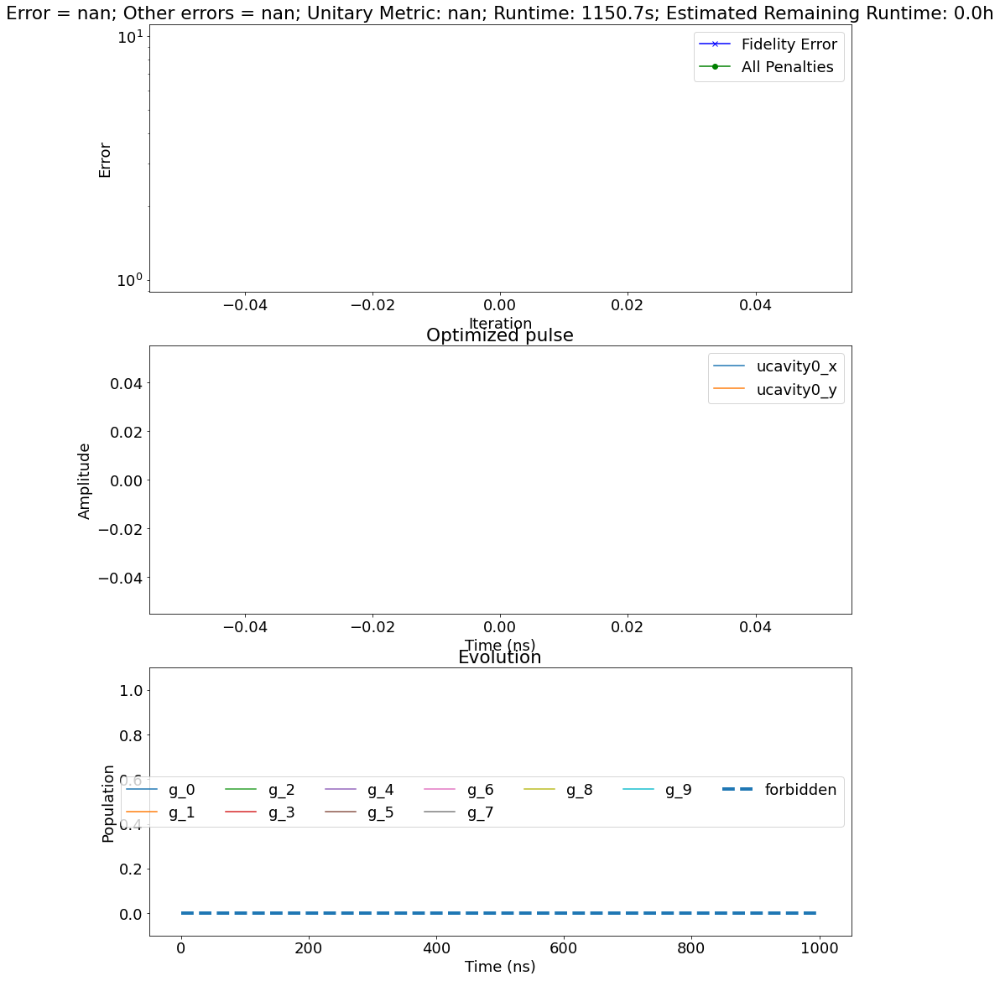

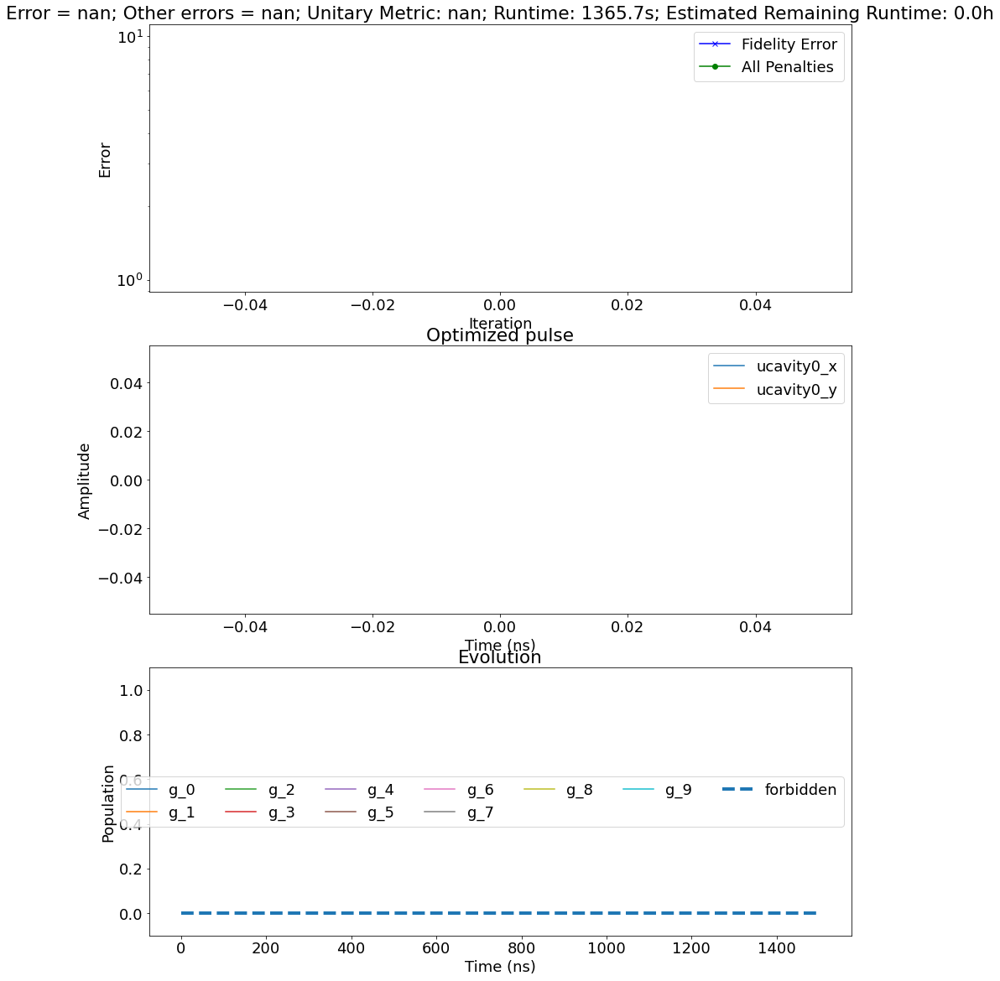

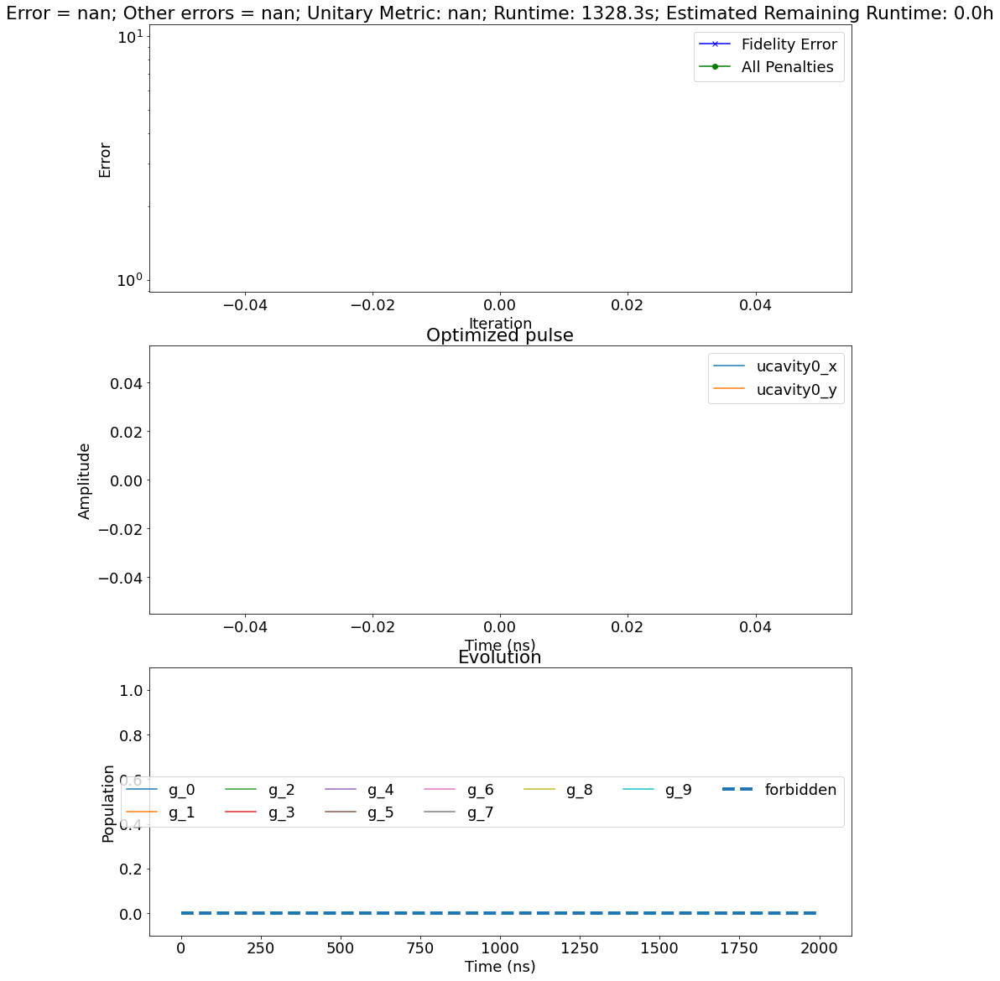

In [15]:
main()

# DUMP

In [44]:
import sys
sys.path

['/home/eag190/Multimode-Conditional-Displacements/hpc_runs/multimode_circle_grape/sample workflow',
 '/home/eag190/miniconda3/envs/simulations/lib/python39.zip',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/lib-dynload',
 '',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/site-packages',
 '/cache/home/eag190/ECD_control',
 '/home/eag190/miniconda3/envs/simulations/lib/python3.9/site-packages/quantum_optimal_control-0.1.0-py3.9.egg']

In [45]:
data_path = ''#'/home/eag190/Multimode-Conditional-Displacements/hpc_runs/multimode_circle_grape/sample workflow/data'

In [52]:
mode = 2
mode_levels = 10
#chi,kappa = chis[mode]*1e-3,kappas[mode]*1e-6
circle_grape_params = {"chis":[chi],"kappas":[0],"alpha":300.0,"delta_c":-0.010}

op = multimode_circle_grape_optimal_control(mode_state_num = mode_levels,
                                            number_of_modes = 1,hparams = circle_grape_params,add_disp_kerr=False)


states_forbidden_list = []
total_time = 500.0
steps  = 100

convergence = {'rate': 0.1, 'update_step': 10, 'max_iterations': 1000,
               'conv_target': 3e-4, 'learning_rate_decay': 500.0}


reg_coeffs = {'dwdt': 0.1, 'd2wdt2': 1.0e-3, 'forbid_dressed': False,
              'states_forbidden_list':states_forbidden_list,
              'forbidden_coeff_list': [1.0*steps] * len(states_forbidden_list)}



initial_guess = None
# initial_guess = np.ones((2, int(steps))) * 2*np.pi * 10.0e-6/np.sqrt(2)
# initial_guess = np.random.normal(loc=0.0, scale=2*np.pi*15e-7, size=(len(Hops), int(steps)))


# expt_name = 'g0_to_g2_blockade'
# file_number = 29
# initial_pulse = "S:/_Data/191018 - Picollo cavity cooldown 15 real\\optimal control pulses\\blockade_pulses\\" + \
#                 str(file_number).zfill(5) + "_" + expt_name.lower()+".h5"

# with h5py.File(initial_pulse,'r') as hf:
#     last_u0 = np.array(hf['uks'])[-1]
# initial_guess = last_u0


op.run_optimal_control(state_transfer = True, initial_states = [0], target_states = [1], 
                        total_time = total_time, steps = steps,max_amp = 1, 
                        taylor_terms = None,is_dressed=False, 
                        convergence = convergence, reg_coeffs =  reg_coeffs,
                        plot_only_g = True,
                        states_forbidden_list = states_forbidden_list,initial_guess = initial_guess, 
                        file_name="g0_to_g1_circlgrape", data_path=data_path)

TypeError: 'NoneType' object is not subscriptable

<Figure size 432x288 with 0 Axes>

In [ ]:
hf = op.openfile()

In [ ]:
hf['error'][-1]

In [ ]:
op.plot_pulses()

In [ ]:
ss

In [ ]:
len(ss[0][0])

In [ ]:
op.fidelity()

In [ ]:
import os 
data_path = '/home/eag190/Multimode-Conditional-Displacements/hpc_runs/multimode_circle_grape/sample workflow/data'
file_path = 'test.h5'
file_path_f = os.path.join(data_path, file_path)
file_path_f

In [ ]:
hf = h5py.File(file_path_f, 'w')


In [ ]:
get_dressed_info

In [ ]:
w_c, v_c, dressed_id = get_dressed_info(op.H_rot())

In [ ]:
w_c

In [ ]:
v_c

In [ ]:
dressed_id